## Import

In [1]:
#import 
import pickle
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from IPython.display import display, HTML
from sklearn import preprocessing
% matplotlib inline

In [2]:
#pandas option
pd.set_option('display.width', 1200) #최대가로길이
pd.set_option('display.max_colwidth', 100) #최대탭길이
pd.set_option('float_format', '{:f}'.format) # 숫자형 표기

## Data load

In [3]:
#load 
data1 = pd.read_csv("./ia_channel_master_0-1M.csv",encoding='utf-8')
data2 = pd.read_csv("./ia_channel_master_1-2M.csv",encoding='utf-8')
data3 = pd.read_csv("./ia_channel_master_2-3M.csv",encoding='utf-8')
data4 = pd.read_csv("./ia_channel_master_3-4M.csv",encoding='utf-8')
data5 = pd.read_csv("./ia_channel_master_4-5M.csv",encoding='utf-8')
data6 = pd.read_csv("./ia_channel_master_5-6M.csv",encoding='utf-8')
data7 = pd.read_csv("./ia_channel_master_6-7M.csv",encoding='utf-8')
data8 = pd.read_csv("./ia_channel_master_7-8M.csv",encoding='utf-8')
data9 = pd.read_csv("./ia_channel_master_8-9M.csv",encoding='utf-8')
data10 = pd.read_csv("./ia_channel_master_9-10M.csv",encoding='utf-8')

C:\Users\mediance_ssh\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2714: DtypeWarning:

Columns (5,6,7,12,13,14,25,26,36,38,39) have mixed types. Specify dtype option on import or set low_memory=False.



In [4]:
# data merge
data = pd.concat([data1,data2,data3,data4,data5,data6,data7,data8,data9,data10])

In [5]:
data = data[data['cm_trackdate'].notnull()] # 트레킹안된 데이터 제거

In [6]:
data.shape

(5732982, 41)

## Function

In [7]:
def sigmoid(n):    
    return 1 / (1 + np.exp(-n))

In [8]:
def sigmoid_derivative(n,gradient_L=1, gradient_R=1):
    return sigmoid(n*gradient_L) * (1 - sigmoid(n*gradient_R))

In [164]:
def norm_scaler(data=None):
    if data is None : return None    
    result = (data-data.min()) / (data.max()-data.min())
    result = pd.Series(result).values
    return result

In [176]:
def norm_standard(data=None, bias=1) :
    if data is None : return None    
    result = (data - data.mean(axis=0)*bias) / data.std(axis=0) #평균값조정
    result = pd.Series(result).values
    return result

In [357]:
def scatter(data, x_name, y_name, c_name):
    plt.figure(figsize=(15,10))
    plt.scatter(data[x_name], data[y_name], c=data[c_name], cmap='viridis', s=3)    
    plt.colorbar()

In [358]:
def scatter3d(data,x_name,y_name,z_name,c_name,info_name) : 
    fig = go.Figure(data=[go.Scatter3d(
        x=data[x_name],
        y=data[y_name],
        z=data[z_name],
        mode='markers',
        marker=dict(
            size=1,
            color=data[c_name],  # set color to an array/list of desired values
            colorscale='Viridis',   # choose a colorscale
            opacity=1,        
        ),
        hovertext=data[info_name]
    )])

    # tight layout
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    fig.show()

In [168]:
# file save
def save_pdata(file_path,data) : 
    with open(file_path,'wb') as f:
        pickle.dump(data, f)
        f.close
        print('pickle write')

In [169]:
# file load
def load_pdata(file_path) :
    with open(file_path, 'rb') as f :        
        return pickle.load(f)

## Preprocessing

In [35]:
#전체탐색

0 765841 141.90562468188458


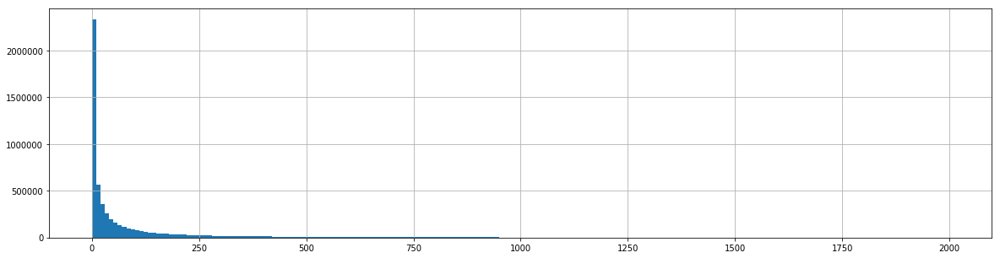

In [134]:
print(data['cm_media_cnt'].min(), data['cm_media_cnt'].max(), data['cm_media_cnt'].mean())
selected = data[data['cm_media_cnt']<2000]
selected['cm_media_cnt'].hist(bins=200, density=False, figsize=(20,5))

0 318472535 1208.3425149224897


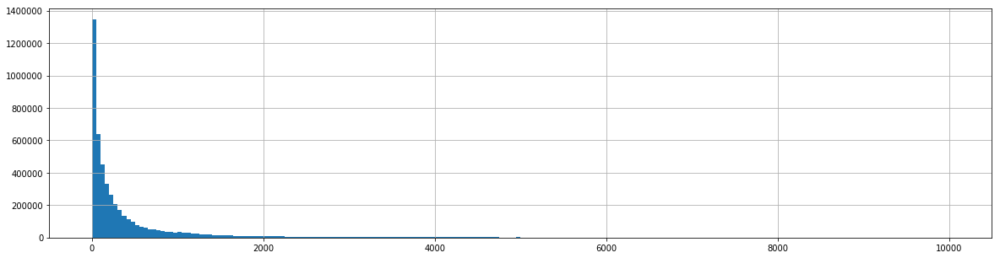

In [120]:
print(data['cm_follower_cnt'].min(), data['cm_follower_cnt'].max(), data['cm_follower_cnt'].mean())
selected = data[data['cm_follower_cnt']<10000]
selected['cm_follower_cnt'].hist(bins=200, density=False, figsize=(20,5))

0 8249


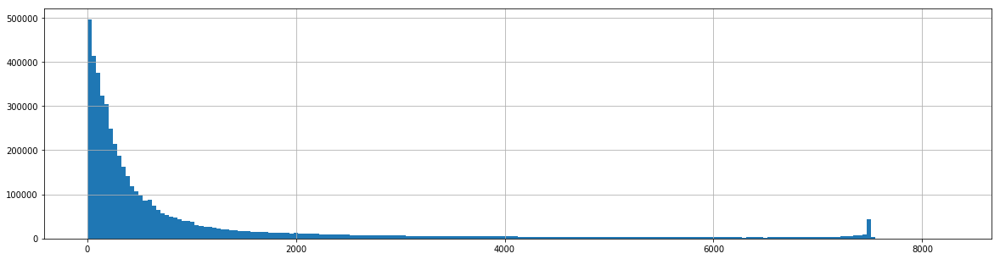

In [219]:
print(data['cm_following_cnt'].min(), data['cm_following_cnt'].max())
selected = data
selected['cm_following_cnt'].hist(bins=200, density=False, figsize=(20,5))

In [47]:
'''
목적에따라 데이터 가공을 다르게할 수 있음
최종목적은 fake를 걸러내고 influencer를 정렬해 볼 수 있도록하는것
follower list의 health check가 반영되도록

1.전체기준정규화
2.정규화기준%로 극단 제거
3.중간층 기준으로 탐색
'''

'\n목적에따라 데이터 가공을 다르게할 수 있음\n최종목적은 fake를 걸러내고 influencer를 정렬해 볼 수 있도록하는것\nfollower list의 health check가 반영되도록\n\n1.전체기준정규화\n2.정규화기준%로 극단 제거\n3.중간층 기준으로 탐색\n'

In [170]:
# 조건
'''
1. post적은것 제거 (비활동) 20<정상<5000
2. follower적은것 제거 (비영향력) or 너무높은것 제거(ex.instagram)
3. following 높은것 제거 (봇일가능성)
'''
# selected = data[(data['cm_attr_private']==0)&\
#                 (data['cm_language']=='ko')&\
#                 (data['cm_media_cnt']>50)&(data['cm_media_cnt']<20000)&\
#                 (data['cm_follower_cnt']>3000)&(data['cm_follower_cnt']<10000000)] 


selected = data
print(selected.shape)

(5732982, 42)


In [171]:
# standardization (z-score)
# (data-data.mean) / data.std 
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# scaler.fit_transform(data)

# normalize (min-max scalar 0~1)
# (data-data.min) / (data.max-data.min)
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler()
# scaler.fit_transform(data)


## Make selection value

In [365]:
# 영역 세부조정

#초기화
real_score = 0
fake_score = 0


# media x축은 범위, 기준 이동 축비대칭 가능?
# 정규화-액티브펑션의 영역에 맞는것... 
# standardzation? 커스터마이즈 해야함
# 2.sigmoid-미분 함수로 영역설정
# standardzation하고 sigmoid-미분하고 비슷하게 생겼네?
# 구간별 차등가중치는...선형회귀로 가능?

#real
#평균은의미없음, 참고만, followercount 중요
#follower/following 비율
#절대값 조금..
meval=0
frval=0
fwval=0
w1 = -1
w2 = 0.3
w3 = 0.5

# norm_range = norm_scaler(selected['cm_follower_cnt'])
# frval = w1 * -pow(np.log10(sigmoid(norm_range*10)),2)

# norm_range = norm_scaler( abs(norm_standard(selected['cm_media_cnt'],1.8)) )
# meval = w2 * sigmoid_derivative(norm_range*10)

# norm_range = norm_scaler( abs(norm_standard(selected['cm_following_cnt'],0.5)) )
# fwval = w3 * sigmoid_derivative(norm_range*6)


##### 전체데이터를 두고 선택하는 방식이 가장 깔끔하다. 시도중
# norm_range = norm_standard(selected['cm_follower_cnt'])
# frval = w1 * sigmoid_derivative(norm_range*10,1,3)

norm_range = norm_standard(selected['cm_media_cnt'],0.2)
meval = w2 * sigmoid_derivative(norm_range*1.2,3,0.2)

# norm_range =norm_standard(selected['cm_following_cnt'],0.5)
# fwval = w3 * sigmoid_derivative(norm_range*1.2,1.5,1)

# norm_range = norm_scaler( norm_standard(selected['cm_following_cnt'] / selected['cm_follower_cnt']) )
# raval = w3 * sigmoid(norm_range*10) # 팔로잉/팔로워


real_score = frval+meval+fwval+raval

#fake
#극단쪽만제거 following높은쪽, media적은쪽, follower적은쪽
meval=0
fwval=0
raval=0
w1 = 1
w2 = 0.8
w3 = 1.5

# norm_range = norm_scaler( abs(norm_standard(selected['cm_media_cnt'],1.8)) )
# meval = w1 * -sigmoid_derivative(norm_range*10)

# norm_range = norm_scaler(abs(norm_standard(selected['cm_following_cnt'],0.5)))
# fwval = w2 * -sigmoid_derivative(norm_range*7)

# norm_range = norm_scaler( norm_standard(selected['cm_following_cnt']/selected['cm_follower_cnt']) )
# raval = w3 * sigmoid(norm_range*10) # 팔로잉/팔로워

fake_score = meval+fwval+raval

# follower값이 크게차이나서 민감도증가.. 
selected['score'] = real_score - fake_score
print(selected['score'].min(), selected['score'].max())

0.0 0.12881871335242492


In [372]:
sample = selected[selected['cm_media_cnt']<5000].sample(frac=1)
print(sample.shape)

(5725516, 42)


In [ ]:
# matplotlib scatter
scatter(sample,'cm_media_cnt','cm_following_cnt','score')

In [ ]:
# 3d scatter
scatter3d(sample,'cm_media_cnt','cm_following_cnt','cm_follower_cnt','score','cm_name')

In [702]:
selected = selected.sort_values(by='score',ascending=0)
# selected = selected.reset_index()

In [703]:
pointer = int(len(selected)*0.0001)
print(pointer,'/',len(selected))
display(HTML(selected[['cm_link','cm_name','cm_media_cnt','cm_follower_cnt','cm_following_cnt','score']][pointer:pointer+30].to_html(index=True)))

6 / 68148


,cm_link,cm_name,cm_media_cnt,cm_follower_cnt,cm_following_cnt,score
457999,https://www.instagram.com/dj_siena/,DJ SIENA 박시현 park sihyun,1207,562219,634,-0.142375
176577,https://www.instagram.com/sora_pppp/,박소라🐶,1870,992085,377,-0.144465
972719,https://www.instagram.com/hyunheehong/,홍현희,1173,364705,1147,-0.145490
480008,https://www.instagram.com/haneulina/,Ha Neul 하늘,2578,1296561,554,-0.146674
370111,https://www.instagram.com/sambahong/,hongjinyoung 홍진영,2331,2248710,371,-0.146796
156641,https://www.instagram.com/2__yun__2/,정다윤 🇰🇷,1119,452415,669,-0.148768
464030,https://www.instagram.com/chungjizzle/,ChungJae Kim 김충재,640,562016,893,-0.149011
67970,https://www.instagram.com/hwa.min/,화민,549,1087626,561,-0.150473
343139,https://www.instagram.com/soobin1119/,Yang Soo Bin(양수빈),1480,713487,359,-0.152473
151930,https://www.instagram.com/jess.02.23/,'JESS',1341,512254,481,-0.153325


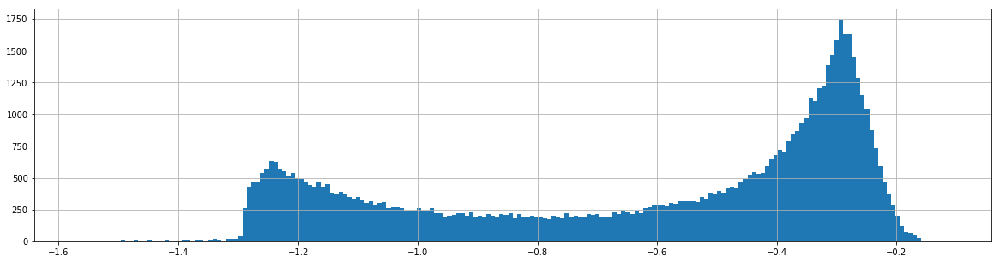

In [704]:
selected['score'].hist(bins=200, density=False, figsize=(20,5))

In [705]:
selected.shape

(68148, 42)

## Follower list 분석

In [ ]:
'''
follower list의 
1. targeting 
- 포스트 정보에서 해시태그 카테고라이징..
2. fake follower제거
- 전체기준 fake follower 점수확인? 
- less media, much following
- follower는 결과적으로 적거나 fake일 가능성 높음
'''

In [1035]:
# 일단 전체데이터 기준 확인
meval=0
fwval=0
w1 = 1
w2 = 0.5

# norm_range = norm_scaler( abs(norm_standard(data['cm_media_cnt'],0)) )
# meval = w1 * sigmoid_derivative(norm_range*1)

meval = w1*pow(sigmoid_derivative(norm_standard(data['cm_media_cnt'],1),0.08,0.5),2)

# norm_range = norm_scaler( abs(norm_standard(selected['cm_following_cnt'],0.5)) )
# fwval = w2 * sigmoid_derivative(norm_range*6)

fwval = -w2*sigmoid_derivative(norm_standard(data['cm_following_cnt'],0.5),0.5,1)

fake_score = meval+fwval
data['temp_fake_score'] = fake_score

print(data['cm_media_cnt'].min(), data['cm_media_cnt'].max(), data['cm_media_cnt'].mean())
print(data['cm_following_cnt'].min(), data['cm_following_cnt'].max(), data['cm_following_cnt'].mean())
print(fake_score.min(), fake_score.max())

0 765841 141.90562468188458
0 8197 920.1974851831037
-0.13271500299177538 0.06404605696148157


In [1036]:
sample = data.sample(frac=0.01)
print(sample.shape)

(57330, 43)


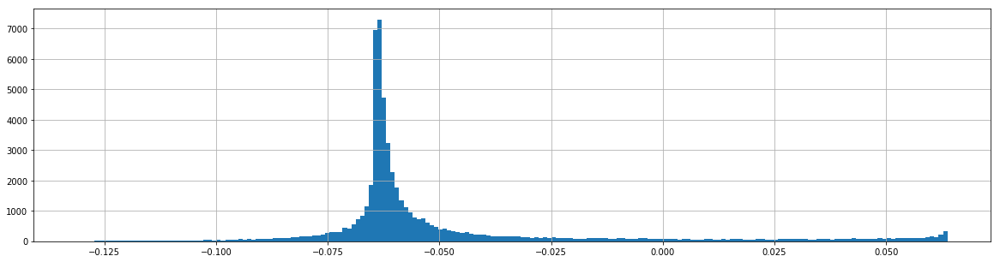

In [1037]:
sample['temp_fake_score'].hist(bins=200, density=False, figsize=(20,5))

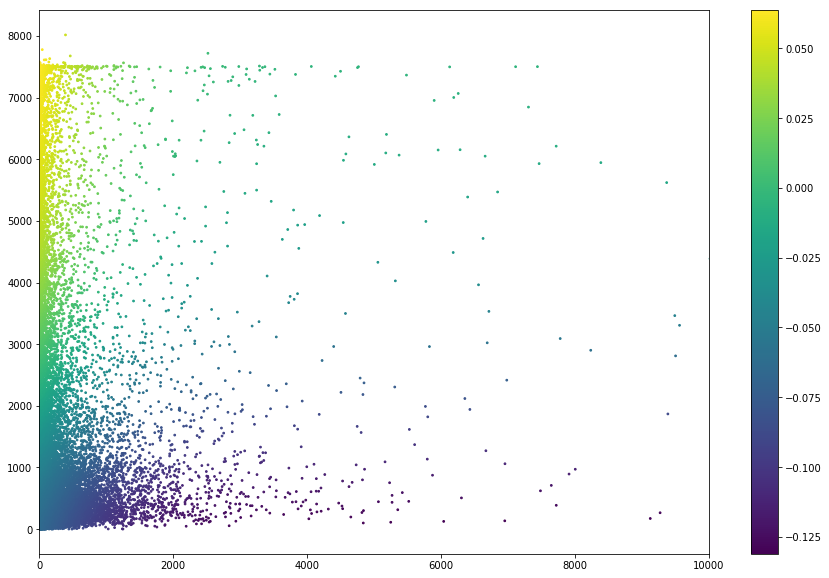

In [1043]:
# matplotlib scatter
scatter(sample,'cm_media_cnt','cm_following_cnt','temp_fake_score')

In [ ]:
################################################################################################

In [522]:
file_path = './followers_health_value.pickle'
selected2 = selected[selected['cm_follower_sample'].notnull()] # follower list가 수집된 row
selected2.shape

(66036, 42)

In [523]:
# follower list
cm_follower_sample_list = {'cm_id':selected2['cm_id'],
                           'list':selected2['cm_follower_sample'].str.split(',')}

In [133]:
# 대략분당 100개
import timeit
followers_value_list = []
starttime = timeit.default_timer()

for i, cmid_list in enumerate(cm_follower_sample_list['list']) : 
    followers = data[(data['cm_id'].isin(cmid_list)) & (data['cm_trackdate'].notnull()) ] # 전체data에서 검색 이게느림
    followers_value_list.append([cm_follower_sample_list['cm_id'].iloc[i],
                                 followers['cm_media_cnt'].sum(),
                                 followers['cm_follower_cnt'].sum(),
                                 followers['cm_following_cnt'].sum(),
                                 len(followers)]) # data에 아직 없는 경우 0이 나온다
    
    if int(i%1000)==0 :         
        timecheck = timeit.default_timer() - starttime
        print('======{0}h:{1}m======'.format(int(timecheck/3600), int(timecheck%3600/60)))
        print(len(followers_value_list))
        
print('complete')
save_pdata(file_path, followers_value_list) # 파일저장

======0h:0m======
1
======0h:17m======
1001
======0h:33m======
2001
======0h:50m======
3001
======1h:6m======
4001
======1h:21m======
5001
======1h:37m======
6001
======1h:53m======
7001
======2h:8m======
8001
======2h:22m======
9001
======2h:37m======
10001
======2h:51m======
11001
======3h:6m======
12001
======3h:20m======
13001
======3h:33m======
14001
======3h:47m======
15001
======4h:1m======
16001
======4h:15m======
17001
======4h:28m======
18001
======4h:42m======
19001
======4h:56m======
20001
======5h:9m======
21001
======5h:23m======
22001
======5h:37m======
23001
======5h:50m======
24001
======6h:4m======
25001
======6h:17m======
26001
======6h:31m======
27001
======6h:44m======
28001
======6h:58m======
29001
======7h:11m======
30001
======7h:24m======
31001
======7h:38m======
32001
======7h:51m======
33001
======8h:5m======
34001
======8h:18m======
35001
======8h:31m======
36001
======8h:44m======
37001
======8h:57m======
38001
======9h:9m======
39001
======9h:22m======
400

In [ ]:
# follower list 지수는 시간이 오래걸리므로 파일저장을 하는것이 좋겠다

In [588]:
followers_health_value = pd.DataFrame(load_pdata(file_path))
print(followers_health_value.shape, selected2.shape)

(66036, 5) (66036, 43)


In [643]:
followers_health_value.head()

,1,2,3,4,5
0,,,,,
23791684715,8128,19050,32137,41,0.000208
23785337959,8364,13398,65072,36,0.000581
23219191185,1236,10025,10888,11,0.000878
23059126116,5693,47429,157394,308,0.000583
22902585778,86343,91692,177568,314,0.000022


In [590]:
# 정렬
followers_health_value = followers_health_value.sort_values(by=0, ascending=0)
selected2 = selected2.sort_values(by='cm_id',ascending=0)

In [592]:
# index 맞추기 set_index('cm_id')
followers_health_value = followers_health_value.set_index(0)
followers_health_value.head()

,1,2,3,4
0,,,,
23791684715,8128,19050,32137,41
23785337959,8364,13398,65072,36
23219191185,1236,10025,10888,11
23059126116,5693,47429,157394,308
22902585778,86343,91692,177568,314


In [594]:
# selected2 = selected2.set_index('cm_id')
selected2.head()

,cm_seq,cm_platform_code,cm_username,cm_link,cm_name,cm_about,cm_picture_url,cm_impression,cm_media_cnt,cm_follower_cnt,...,cm_track_period,cm_tracking_flag,cm_trackdate,cm_follower_tracking_flag,cm_follower_trackdate,cm_history,cm_regdate,score,followers_value,temp_score
cm_id,,,,,,,,,,,,,,,,,,,,,
23791684715,3885193,CPC01,pobling_nailmarket,https://www.instagram.com/pobling_nailmarket/,뽀블링네일마켓 도소매 네일재료,#dm문의환영 #수강문의 #젤연장 #케어 #젤네일\n.\n카카오톡:뽀블링네일마켓\n.\n#스와로브스키 #뽀블링네일마켓 #부평네일재료도소매 #부평속눈썹재료 #네일아트국가고시\...,https://scontent-hkg3-1.cdninstagram.com/vp/85c9fc632f51e39ccb5ec084c35b53ca/5E84ABB6/t51.2885-1...,6375,85,6375,...,7,1,2019-12-02 20:20:00,0,2019-12-03 12:45:03,2019-12-02 20:20:00 | AWS LAMBDA TRACKING (by Python 6)\r\n2019-12-02 20:17:17 | AWS LAMBDA TRAC...,2019-11-04 04:45:01,-0.431854,0.000001,-1.029388
23785337959,3144252,CPC01,mona_sexy.red.secret,https://www.instagram.com/mona_sexy.red.secret/,Mona(페이모델),1. 11월 촬영마감하며 12월은 치아교정 후 회복기간에 따라 일정 잡을예정으로 따로 촬영문의 받지 않습니다. \n2. 촬영문의 외 사적인 연락 하지 않습니다.\n3. 웹화...,https://scontent-hkg3-2.cdninstagram.com/vp/a25223e76125275672fd5292d0f8d053/5E741343/t51.2885-1...,19361,77,19361,...,5,1,2019-11-29 01:19:25,0,2019-11-30 13:15:02,2019-12-05 15:53:31 | 채널명 변경 | mona_red_sexy_secret > https://www.instagram.com/mona_sexy.red.se...,2019-11-02 17:35:01,-0.283500,0.000000,-1.081650
23219191185,7067566,CPC01,91.mks,https://www.instagram.com/91.mks/,더 많은 제품은 카카오스토리 검색👉🏻91markets,❣️재오픈 new open\n-\n❣️카드&소액결제 가능\n(수수료 부담)\n-\n-\n저희는 양심을 팔지 않습니다\n믿어주시는분들 감사합니다\n-\n⬇️카톡하기⬇️,https://scontent-hkg3-2.cdninstagram.com/vp/d8bfac7afe16730049d7e85be71a4f0e/5E80ED41/t51.2885-1...,3068,114,3068,...,10,1,2019-12-04 04:57:00,0,2019-12-04 14:08:03,2019-12-04 04:57:00 | AWS LAMBDA TRACKING (by Python 5)\r\n2019-12-04 04:55:21 | AWS LAMBDA TRAC...,2019-11-13 04:40:01,-0.387928,0.000000,-0.976668
23059126116,206619,CPC01,kong.sta,https://www.instagram.com/kong.sta/,콩순이,콩스타 맞팔환영 소통해요❤\n문의는 DM,https://scontent-sin6-1.cdninstagram.com/vp/714e608919735f26d0d85bfc0162c435/5E85131C/t51.2885-1...,6168,86,6168,...,7,1,2019-12-01 15:13:20,0,2019-11-12 02:28:04,2019-12-01 15:13:20 | AWS LAMBDA TRACKING (by Python 4)\r\n2019-11-24 16:50:02 | AWS LAMBDA TRAC...,2019-10-30 00:15:01,-0.296776,0.000006,-0.850800
22902585778,138967,CPC01,story_farmers,https://www.instagram.com/story_farmers/,스토리파머스 A/S 되는 농산물 산지직송👨‍🌾,제철농수산물을 택배로 식탁까지!\n신선한 온라인 푸드마켓\n-\n-\n⬇️ #스토리파머스 주문은 링크를 클릭하세요 ⬇️,https://scontent-hkg3-2.cdninstagram.com/vp/83fbe66f9d270d4296600a97ef56dbbf/5E6FE5A2/t51.2885-1...,3951,88,3951,...,10,1,2019-11-29 17:22:13,0,2019-11-30 09:34:03,2019-11-29 17:22:13 | AWS LAMBDA TRACKING (by Python 3)\r\n2019-11-29 17:22:03 | AWS LAMBDA TRAC...,2019-10-29 22:25:01,-0.339004,0.000000,-1.492056


In [ ]:
'''
follower list value_avg 값이 높을수록 fake 비중이 높다는 가설(조정필요)
기존 score값에 가중치 넣어서 절대값으로 적용
노멀라이징 필요 0-1
'''

In [ ]:
# followers_value 탐색.... 이거 쓸수있는것인가

In [610]:
# 1.media_cnt 
# 2.follower_cnt 
# 3.following_cnt 
# 4.len(followers)
me_cnt = followers_health_value[1]+1
fr_cnt = followers_health_value[2]+1
fw_cnt = followers_health_value[3]+1
count = followers_health_value[4]

In [706]:
pd.DataFrame(fw_cnt/fr_cnt).sort_values(by=0,ascending=0)

C:\Users\mediance_ssh\Anaconda3\lib\site-packages\ipykernel\__main__.py:1: FutureWarning:

'0' is both an index level and a column label.
Defaulting to column, but this will raise an ambiguity error in a future version



,0
0,
481687913,294.600000
1230180360,271.500000
3168219464,173.000000
5381059779,161.133333
16958147120,114.983051
4254855469,110.666667
1485609283,97.181818
4211565886,90.169935
13561947290,86.688889


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000000FF645358>]],
      dtype=object)

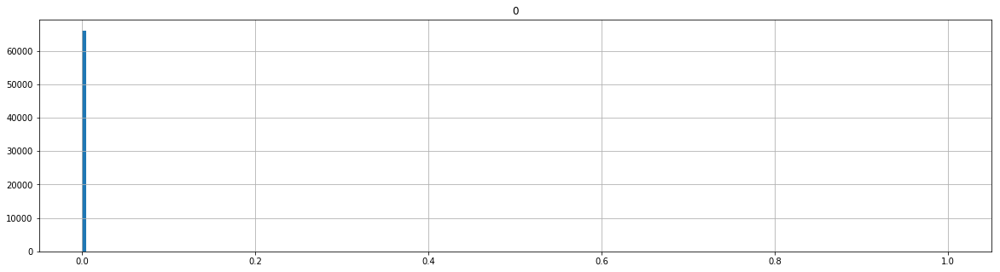

In [677]:
temp_value = fw_cnt+me_cnt
pd.DataFrame( temp_value ).hist(bins=200, density=False, figsize=(20,5))

In [ ]:
scatter()

In [599]:
# database에 없는 follower_sample인경우 count가 0이 나와 값이 infinite가 나옴
# min-max 값 이상함? 보정을 어떻게 해야하나?
# inf => None 변경
followers_value = followers_value.replace(np.inf, None)
selected2['followers_value'] = norm_standard(followers_value) # 배열 index 값에 맞춰서 입력됨
print(selected2['followers_value'].min(), selected2['followers_value'].max())

1.8659596588878036e-07 160.53745877345952


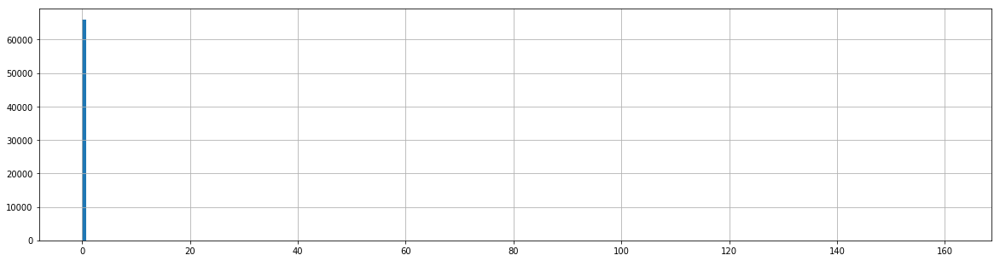

In [600]:
selected2['followers_value'].hist(bins=200, density=False, figsize=(20,5))

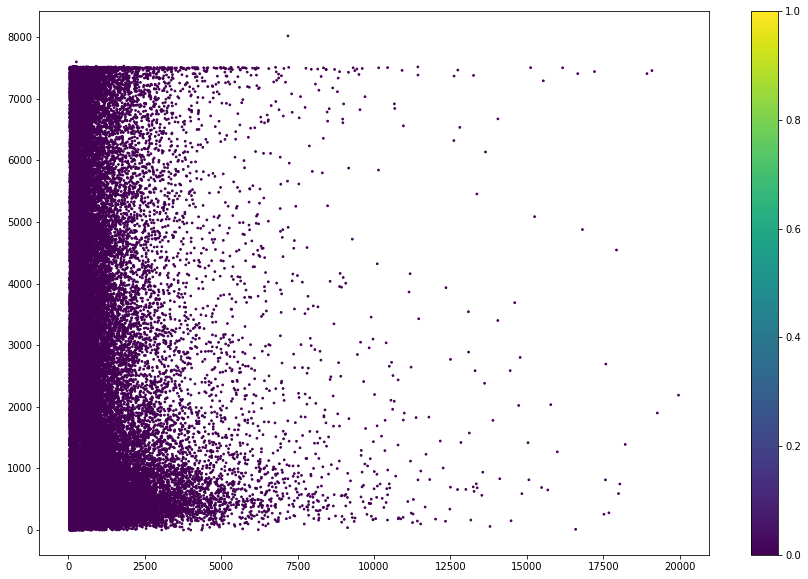

In [575]:
scatter(selected2,'cm_media_cnt','cm_following_cnt','followers_value')

In [552]:
scatter3d(selected2,'cm_media_cnt','cm_following_cnt','cm_follower_cnt','followers_value','cm_name')

In [564]:
# followers_value 적용
w1 = 2
selected2['temp_score'] = selected2['score'] - w1*selected2['followers_value']

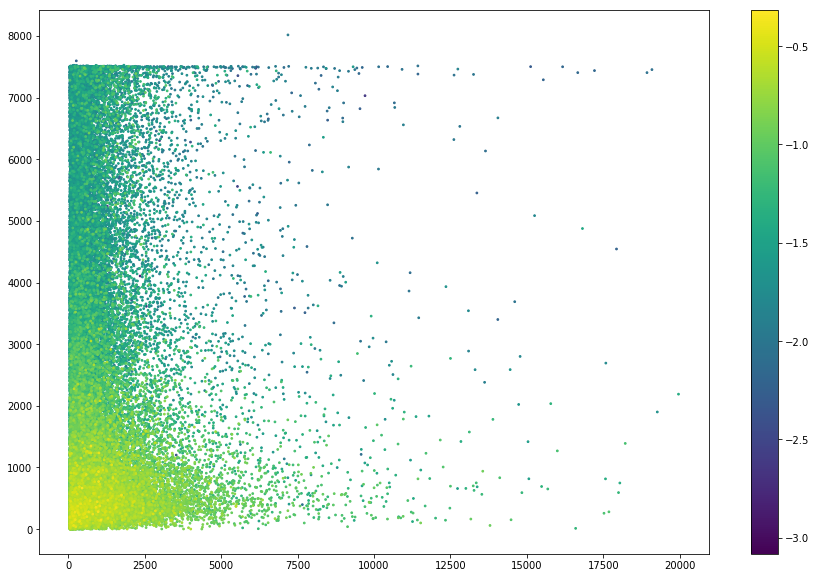

In [565]:
scatter(selected2,'cm_media_cnt','cm_following_cnt','temp_score')

In [558]:
scatter3d(selected2,'cm_media_cnt','cm_following_cnt','temp_score','temp_score','cm_name')

In [629]:
selected2 = selected2.sort_values(by='temp_score',ascending=0)

In [631]:
pointer = int(len(selected2)*0.00001)
print(pointer,'/',len(selected2))
display(HTML(selected2[['cm_link','cm_name','cm_media_cnt','cm_follower_cnt','cm_following_cnt','followers_value','temp_score']][pointer:pointer+30].to_html(index=True)))

0 / 66036


,cm_link,cm_name,cm_media_cnt,cm_follower_cnt,cm_following_cnt,followers_value,temp_score
cm_id,,,,,,,
794954680,https://www.instagram.com/wow_n_n/,NaN,454,26609,665,0.000200,-0.317081
712739754,https://www.instagram.com/foxy.is.me/,#KOREA #MODEL #FOXY #안서린,980,70095,282,0.000120,-0.346944
6967045153,https://www.instagram.com/gnal_yurim/,"연남동네일샵, 그날의네일 유림ෆ",1070,49262,145,0.000011,-0.350929
1440074349,https://www.instagram.com/jinjoo_saengkang/,lee jinjoo,742,39798,1348,0.000082,-0.354526
2174772549,https://www.instagram.com/22ssu_hyun/,I ♡ My babies💕,994,23677,771,0.000023,-0.373186
403665462,https://www.instagram.com/love__coke/,보라쌤 🐰,948,12852,444,0.001038,-0.373554
1281183074,https://www.instagram.com/kangjh1/,강지훈,1744,14801,551,0.000047,-0.374235
1423934283,https://www.instagram.com/owen__yoga/,YOGA OWEN,803,11984,243,0.000077,-0.375327
2218588419,https://www.instagram.com/z1__n8/,アヨン🧸💗,219,11262,274,0.000708,-0.377034


In [642]:
# 확인
selected2.loc[481687913]

cm_seq                                                                                                                   2820129
cm_platform_code                                                                                                           CPC01
cm_username                                                                                                          yangbaby___
cm_link                                                                                   https://www.instagram.com/yangbaby___/
cm_name                                                                                                           치푸추맘 그리고 대형견아내
cm_about                     -\nѕтyle вooĸ @garma_uki\n-\ncнιca       "ᴀʙʏssɪɴɪᴀɴ"\npυca        "sᴄᴏᴛᴛɪsʜ ғᴏʟᴅ"\nвᴀᴇcнυ    "ᴘ...
cm_picture_url               https://scontent-sin2-1.cdninstagram.com/vp/8c9fa8bcefc142f99c5366c6829b7c8a/5E85EAF6/t51.2885-1...
cm_impression                                                                                    